## Running Your First Notebook

In [1]:
from fastai.vision.all import *

In [2]:
path = untar_data(URLs.PETS)/'images'

### let's have a look into the path object we just created:

In [3]:
path

Path('/home/felipe/.fastai/data/oxford-iiit-pet/images')

### as we can see, we have an object that points to the path /home/felipe/.fastai/data/oxford-iiit-pet/images.

### The Path object can also be checked:

In [4]:
Path?

Init signature: Path(*args, **kwargs)
Docstring:     
PurePath subclass that can make system calls.

Path represents a filesystem path but unlike PurePath, also offers
methods to do system calls on path objects. Depending on your system,
instantiating a Path will return either a PosixPath or a WindowsPath
object. You can also instantiate a PosixPath or WindowsPath directly,
but cannot instantiate a WindowsPath on a POSIX system or vice versa.
File:           ~/anaconda3/envs/fastai_v2/lib/python3.7/pathlib.py
Type:           type
Subclasses:     PosixPath, WindowsPath


### further investigating the untar_data function:

In [5]:
untar_data?

Signature:
untar_data(
    url,
    fname=None,
    dest=None,
    c_key='data',
    force_download=False,
    extract_func=<function file_extract at 0x7fed08d2b0e0>,
)
Docstring: Download `url` to `fname` if `dest` doesn't exist, and un-tgz or unzip to folder `dest`.
File:      ~/anaconda3/envs/fastai_v2/lib/python3.7/site-packages/fastai/data/external.py
Type:      function


### and the URLs :

In [6]:
URLs?

Init signature: URLs()
Docstring:      Global constants for dataset and model URLs.
File:           ~/anaconda3/envs/fastai_v2/lib/python3.7/site-packages/fastai/data/external.py
Type:           type
Subclasses:     


### when we call untar_data, we create a folder, if the destination doesn't exist, download the especified dataset from the URLs list and untar the file.

<img src="./figs/giphy.gif" style="width: 450px;" align="center"/>

### In the description of the pets dataset, its stated that capital letters are for cats and small letters are for dogs, lets use this to build our cats dataset:

In [7]:
def is_cat(x): return x[0].isupper()

### createing the dataloader is easy as:

In [8]:
dls = ImageDataLoaders.from_name_func(
    path, get_image_files(path), valid_pct=0.2, seed=42,
    label_func=is_cat, item_tfms=Resize(224))

### Let's just have a look on the function ImageDataLoaders:

In [9]:
ImageDataLoaders??

Init signature: ImageDataLoaders(*loaders, path='.', device=None)
Source:        
class ImageDataLoaders(DataLoaders):
    "Basic wrapper around several `DataLoader`s with factory methods for computer vision problems"
    @classmethod
    @delegates(DataLoaders.from_dblock)
    def from_folder(cls, path, train='train', valid='valid', valid_pct=None, seed=None, vocab=None, item_tfms=None,
                    batch_tfms=None, **kwargs):
        "Create from imagenet style dataset in `path` with `train` and `valid` subfolders (or provide `valid_pct`)"
        splitter = GrandparentSplitter(train_name=train, valid_name=valid) if valid_pct is None else RandomSplitter(valid_pct, seed=seed)
        get_items = get_image_files if valid_pct else partial(get_image_files, folders=[train, valid])
        dblock = DataBlock(blocks=(ImageBlock, CategoryBlock(vocab=vocab)),
                           get_items=get_items,
                           splitter=splitter,
                           get_y=p

### and the function get_image_files:

In [10]:
get_image_files??

Signature: get_image_files(path, recurse=True, folders=None)
Source:   
def get_image_files(path, recurse=True, folders=None):
    "Get image files in `path` recursively, only in `folders`, if specified."
    return get_files(path, extensions=image_extensions, recurse=recurse, folders=folders)
File:      ~/anaconda3/envs/fastai_v2/lib/python3.7/site-packages/fastai/data/transforms.py
Type:      function


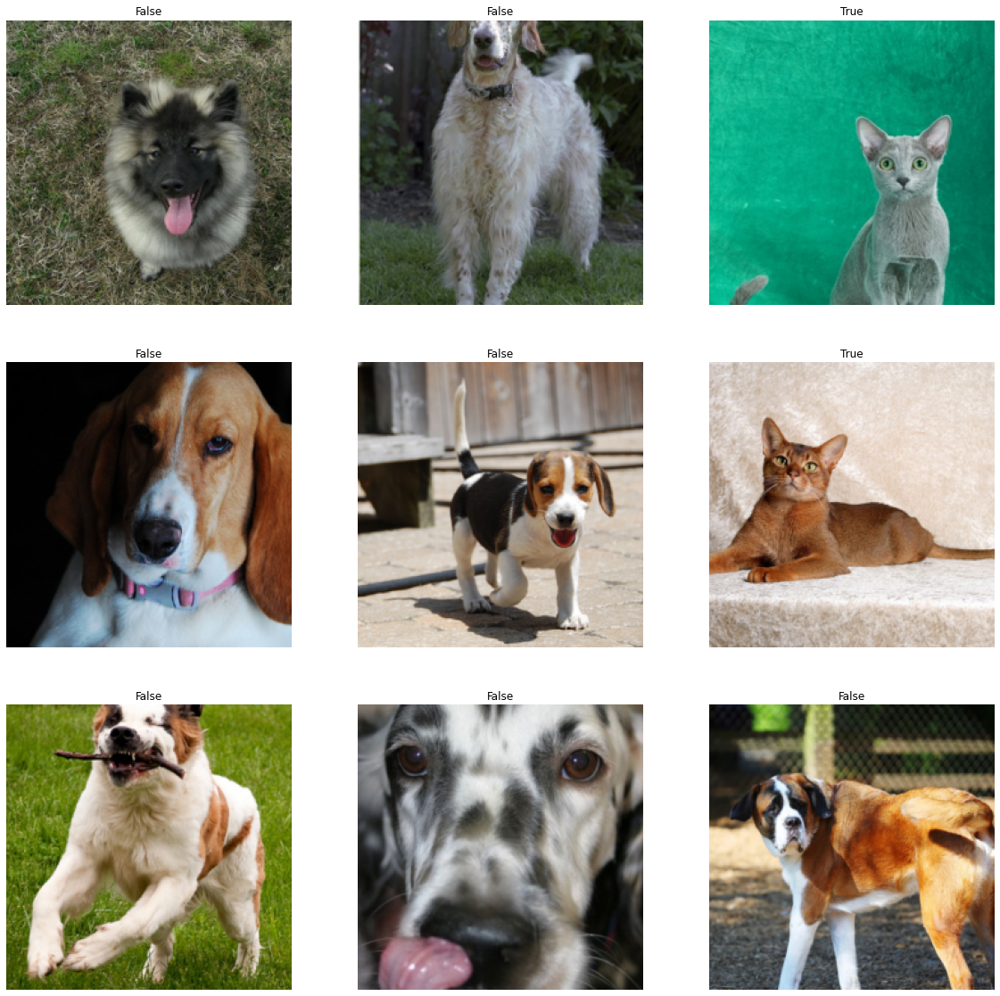

In [11]:
dls.show_batch(figsize=(20,20))

### Now we can build our first deep learning model, to do so we can use the cnn_learner:

In [12]:
learner = cnn_learner(dls, resnet34, metrics=error_rate)

The cnn_learner is a class from fastai that deals with all the hassle of create the deep learning architectures, tensor dim, data workflow, etc.

<img src="./figs/magic.gif" style="width: 450px;" align="center"/>

In [13]:
cnn_learner?

Signature:
cnn_learner(
    dls,
    arch,
    loss_func=None,
    pretrained=True,
    cut=None,
    splitter=None,
    y_range=None,
    config=None,
    n_out=None,
    normalize=True,
    opt_func=<function Adam at 0x7fed06a415f0>,
    lr=0.001,
    cbs=None,
    metrics=None,
    path=None,
    model_dir='models',
    wd=None,
    wd_bn_bias=False,
    train_bn=True,
    moms=(0.95, 0.85, 0.95),
)
Docstring: Build a convnet style learner from `dls` and `arch`
File:      ~/anaconda3/envs/fastai_v2/lib/python3.7/site-packages/fastai/vision/learner.py
Type:      function


In [14]:
resnet34??

Signature: resnet34(pretrained=False, progress=True, **kwargs)
Source:   
def resnet34(pretrained=False, progress=True, **kwargs):
    r"""ResNet-34 model from
    `"Deep Residual Learning for Image Recognition" <https://arxiv.org/pdf/1512.03385.pdf>`_

    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
    """
    return _resnet('resnet34', BasicBlock, [3, 4, 6, 3], pretrained, progress,
                   **kwargs)
File:      ~/anaconda3/envs/fastai_v2/lib/python3.7/site-packages/torchvision/models/resnet.py
Type:      function


In [15]:
dls.loss_func

FlattenedLoss of CrossEntropyLoss()

In [18]:
nn.CrossEntropyLoss?

Init signature:
nn.CrossEntropyLoss(
    weight: Union[torch.Tensor, NoneType] = None,
    size_average=None,
    ignore_index: int = -100,
    reduce=None,
    reduction: str = 'mean',
) -> None
Docstring:     
This criterion combines :func:`nn.LogSoftmax` and :func:`nn.NLLLoss` in one single class.

It is useful when training a classification problem with `C` classes.
If provided, the optional argument :attr:`weight` should be a 1D `Tensor`
assigning weight to each of the classes.
This is particularly useful when you have an unbalanced training set.

The `input` is expected to contain raw, unnormalized scores for each class.

`input` has to be a Tensor of size either :math:`(minibatch, C)` or
:math:`(minibatch, C, d_1, d_2, ..., d_K)`
with :math:`K \geq 1` for the `K`-dimensional case (described later).

This criterion expects a class index in the range :math:`[0, C-1]` as the
`target` for each value of a 1D tensor of size `minibatch`; if `ignore_index`
is specified, this criterion a

### Now its time to train our model by passing the training dataset:

In [19]:
dls.train_ds

(#5912) [(PILImage mode=RGB size=500x340, TensorCategory(0)),(PILImage mode=RGB size=500x333, TensorCategory(1)),(PILImage mode=RGB size=500x332, TensorCategory(1)),(PILImage mode=RGB size=500x375, TensorCategory(0)),(PILImage mode=RGB size=500x333, TensorCategory(0)),(PILImage mode=RGB size=500x333, TensorCategory(0)),(PILImage mode=RGB size=500x375, TensorCategory(1)),(PILImage mode=RGB size=381x480, TensorCategory(0)),(PILImage mode=RGB size=300x199, TensorCategory(0)),(PILImage mode=RGB size=500x375, TensorCategory(0))...]

### but first, lets try to find a good learning rate for our model:

SuggestedLRs(lr_min=0.006918309628963471, lr_steep=0.0003981071640737355)

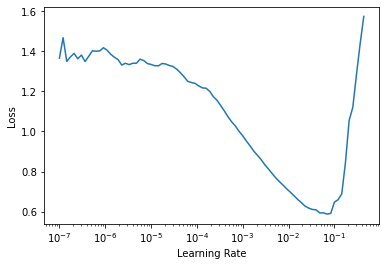

In [20]:
learner.lr_find()

In [21]:
learner.fit_one_cycle(5,lr_max=0.00039)

epoch,train_loss,valid_loss,error_rate,time
0,0.364267,0.033870,0.013532,00:36
1,0.097105,0.014508,0.004736,00:23
2,0.055072,0.020629,0.006766,00:23
3,0.029990,0.011130,0.004736,00:23
4,0.027266,0.011927,0.004736,00:23


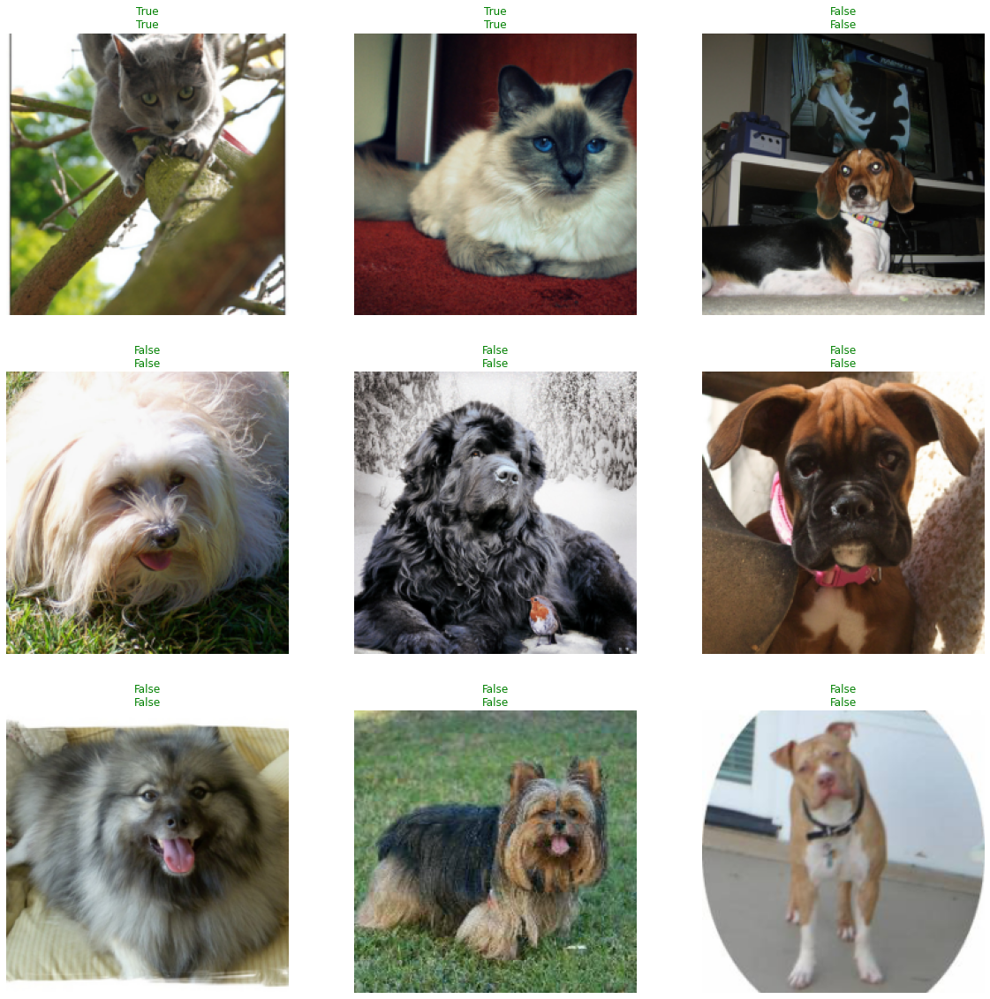

In [22]:
learner.show_results(figsize=(20,20))

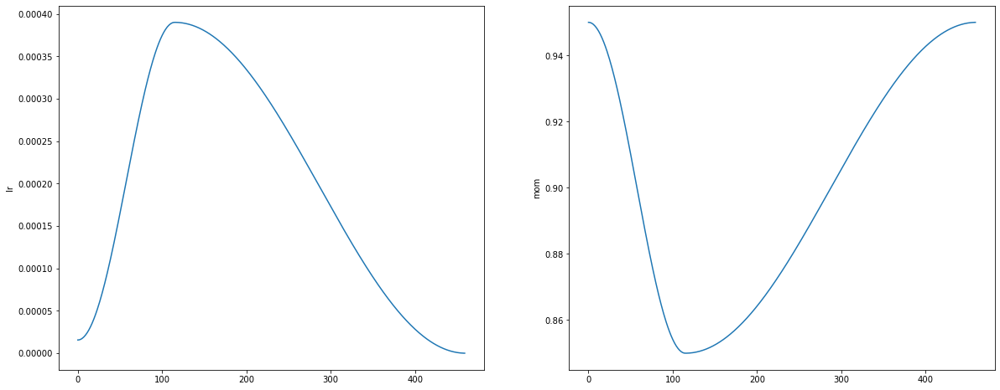

In [26]:
learner.recorder.plot_sched(figsize=(20,8))

In [28]:
learner.recorder.show_training_loop()

Start Fit
   - before_fit     : [TrainEvalCallback, Recorder, ProgressCallback]
  Start Epoch Loop
     - before_epoch   : [Recorder, ProgressCallback]
    Start Train
       - before_train   : [TrainEvalCallback, Recorder, ProgressCallback]
      Start Batch Loop
         - before_batch   : []
         - after_pred     : []
         - after_loss     : []
         - before_backward: []
         - after_backward : []
         - after_step     : []
         - after_cancel_batch: []
         - after_batch    : [TrainEvalCallback, Recorder, ProgressCallback]
      End Batch Loop
    End Train
     - after_cancel_train: [Recorder]
     - after_train    : [Recorder, ProgressCallback]
    Start Valid
       - before_validate: [TrainEvalCallback, Recorder, ProgressCallback]
      Start Batch Loop
         - **CBs same as train batch**: []
      End Batch Loop
    End Valid
     - after_cancel_validate: [Recorder]
     - after_validate : [Recorder, ProgressCallback]
  End Epoch Loop
   - after_

In [29]:
import ipywidgets as widgets

In [30]:
uploader = widgets.FileUpload()

In [31]:
uploader

FileUpload(value={}, description='Upload')

In [36]:
uploader = SimpleNamespace(data = 'figs/IMG_20200827_191930.jpg')

In [41]:
img = PILImage.create(uploader.data)

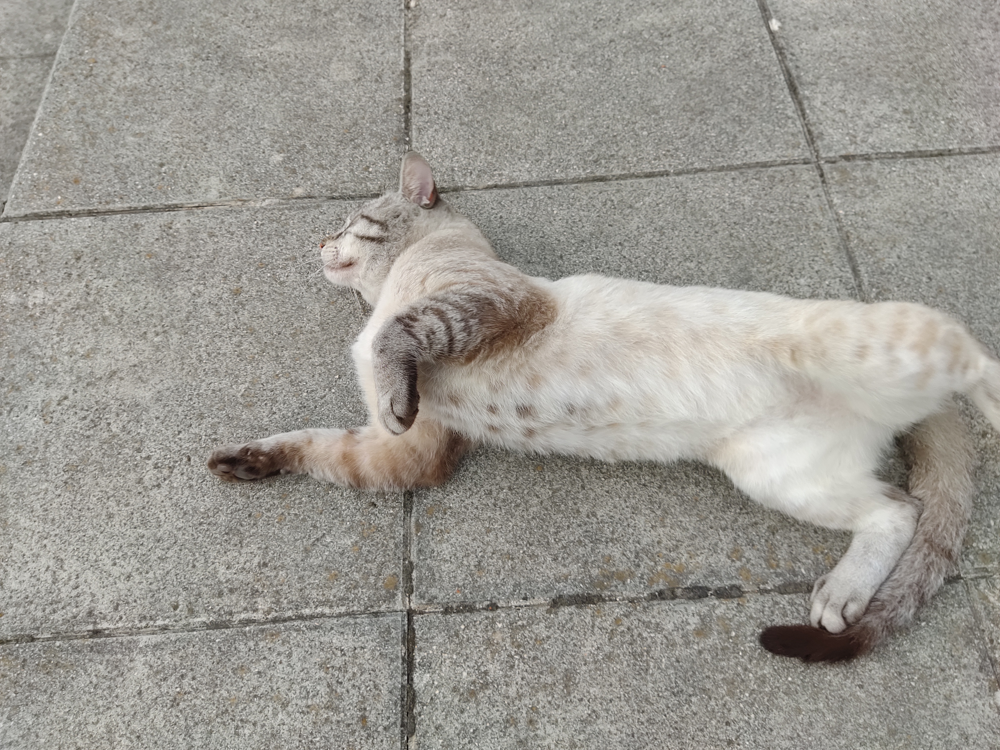

In [42]:
img

In [43]:
is_cat,_,probs = learner.predict(img)

In [44]:
print(f"Is this a cat?: {is_cat}.")
print(f"Probability it's a cat: {probs[1].item():.6f}")

Is this a cat?: True.
Probability it's a cat: 0.998685


In [45]:
img2 = PILImage.create('figs/IMG_20200802_101509.jpg')

In [57]:
is_cat,_,probs = learner.predict(img2)

In [58]:
print(f"Is this a cat?: {is_cat}.")
print(f"Probability it's a cat: {probs[1].item():.6f}")

Is this a cat?: True.
Probability it's a cat: 0.999994


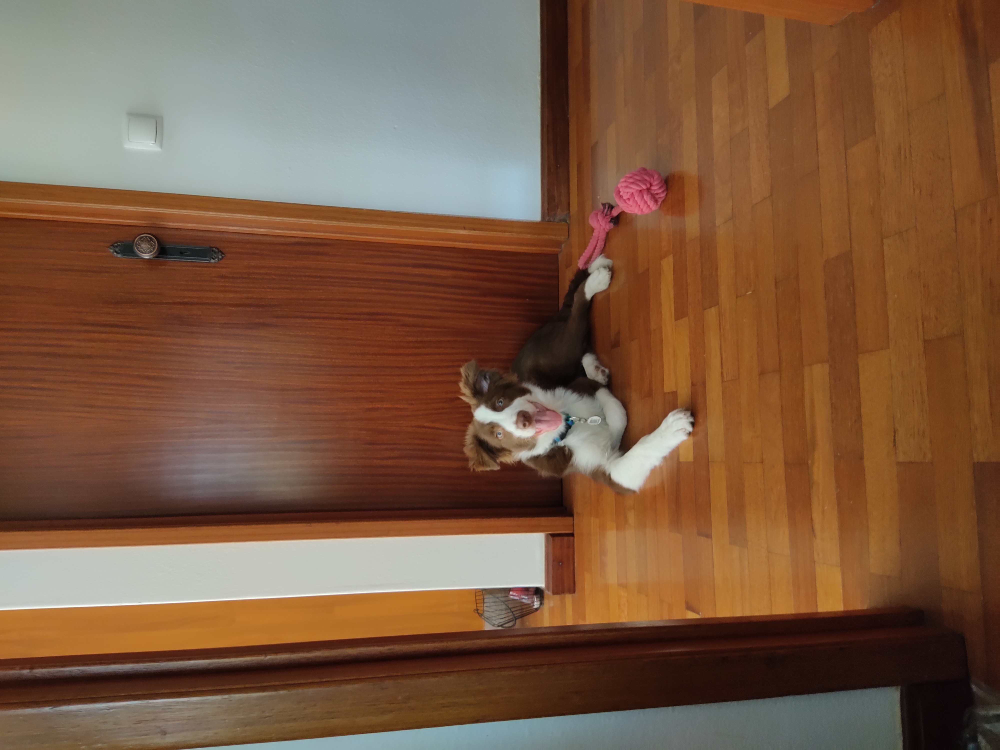

In [59]:
img2

In [61]:
img2 = img2.rotate(-90)

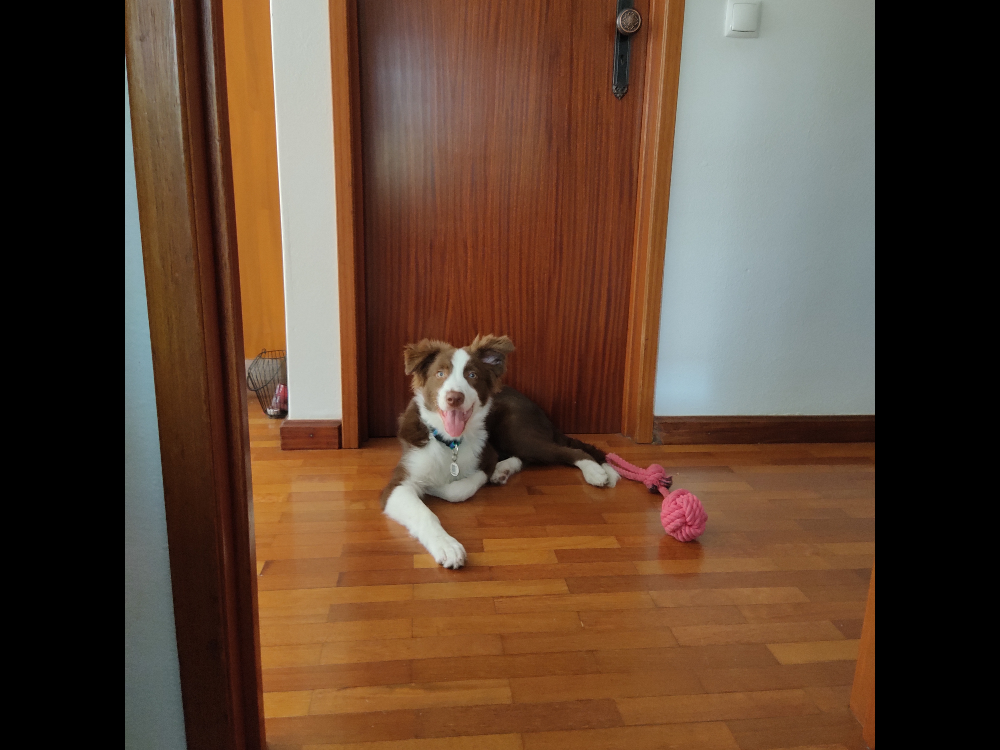

In [62]:
img2

In [67]:
img2c = PILImage(img2)

In [68]:
type(img2c)

fastai.vision.core.PILImage

In [69]:
is_cat,_,probs = learner.predict(img2c)

In [70]:
print(f"Is this a cat?: {is_cat}.")
print(f"Probability it's a cat: {probs[1].item():.6f}")

Is this a cat?: False.
Probability it's a cat: 0.000096
